# Try Negative

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from copy import deepcopy
import shapely.geometry as shapgeo

In [4]:
sample = cv2.imread('/home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/r3_N-36-R_left_half.png')
sample = cv2.cvtColor(sample, cv2.COLOR_BGR2RGB)

In [5]:
from skimage.exposure import match_histograms

In [6]:
IDEAL_DIR = r'/home/tsdhrm/Pictures/thesis/dataset/100DataNew/positive/drishtiGS_069.png'
IDEAL = cv2.imread(IDEAL_DIR)
IDEAL = cv2.cvtColor(IDEAL, cv2.COLOR_BGR2RGB)

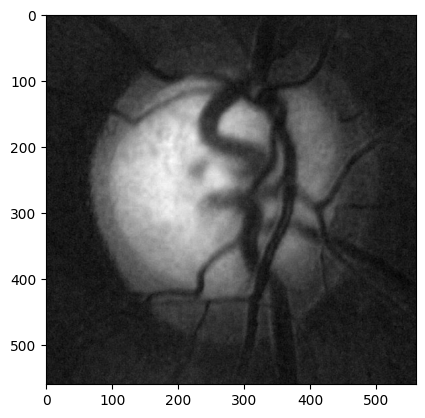

In [7]:
plt.imshow(IDEAL[:,:,2], 'gray')

In [8]:
matched = match_histograms(sample, IDEAL, multichannel=True)

/tmp/ipykernel_7634/2394428667.py:1: FutureWarning: `multichannel` is a deprecated argument name for `match_histograms`. It will be removed in version 1.0. Please use `channel_axis` instead.
  matched = match_histograms(sample, IDEAL, multichannel=True)


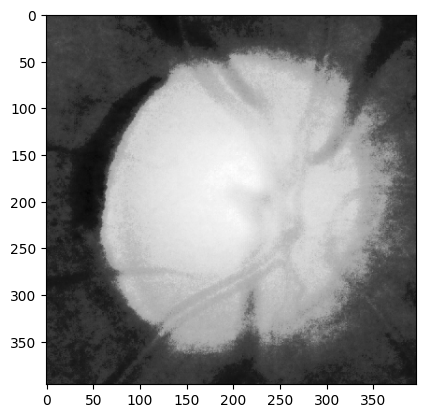

In [9]:
plt.imshow(matched[:,:,0], 'gray')

In [10]:
medblur = cv2.GaussianBlur(matched[:,:,2], (15,15), 0)

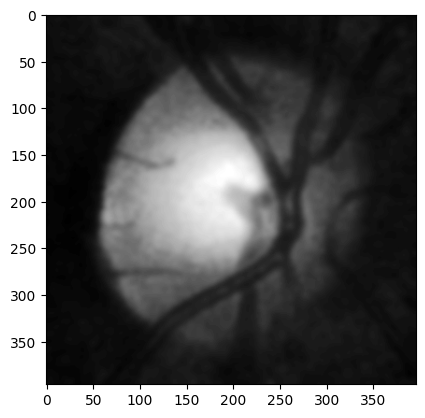

In [11]:
plt.imshow(medblur, 'gray')

In [12]:
def read_files(ddir):
    images = dict()
    ACCEPTED_FORMAT = ['jpg', 'png']
    for d in sorted(os.listdir(ddir)):
        if d.split('.')[1].lower() in ACCEPTED_FORMAT:
            fname = d.split('.')[0]
            print(f'reading {os.path.join(ddir, d)}...')
            images[fname] = cv2.imread(os.path.join(ddir, d))
            images[fname] = cv2.cvtColor(images[fname], cv2.COLOR_BGR2RGB)
    return images

def display_all(imgs, subs=(10,10), fgsz=(15,18), use_gray=False):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz, sharex=True, sharey=True)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            axs[i, j].imshow(list(imgs.values())[k], 'gray' if use_gray else None)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1
            
def display_all_with(imgs, cc, subs=(10,10), fgsz=(15,18), use_gray=True):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            axs[i, j].imshow(list(imgs.values())[k][:,:,cc], cmap='gray' if use_gray else None)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1
            
def save_plots(imgs, suptitle, savedir, subs=(10,10), fgsz=(15,18), use_gray=False):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            axs[i, j].imshow(list(imgs.values())[k], 'gray' if use_gray else None)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1
    fig.suptitle(suptitle)
    fig.savefig(savedir)
    print(f'Figure is successfully saved at {savedir}')

def adjust_gamma(image, gamma=1.0):
    table = np.array([((i / 255.0) ** gamma) * 255
      for i in np.arange(0, 256)]).astype("uint8")

    return cv2.LUT(image, table)

In [13]:
NEGATIVE = r'/home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative'
neg = read_files(NEGATIVE)

reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/001.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/008.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/009.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/010.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/011.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/012.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/015.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/017.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/018.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/021.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/022.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/023.jpg...
reading /home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/024.jpg...
reading /hom

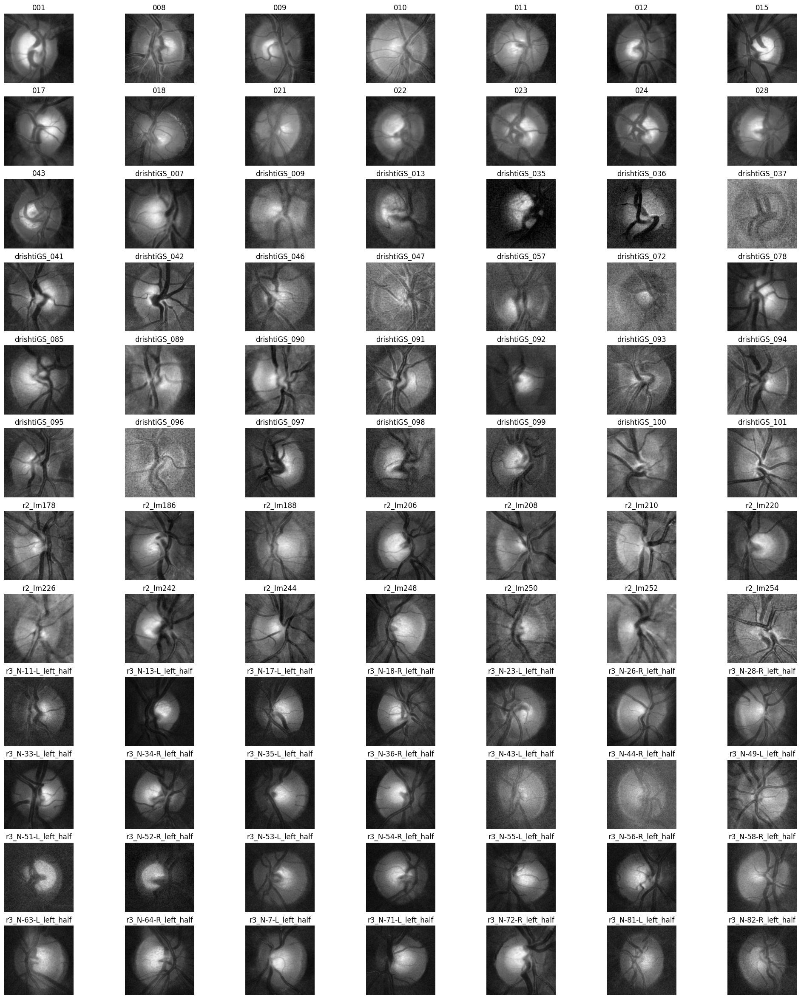

In [14]:
display_all_with(neg, 2, (12,7), (25,30))

In [136]:
pos_matched = {}
for p in neg:
    pos_matched[p] = match_histograms(neg[p], IDEAL, multichannel=True)

/tmp/ipykernel_24985/2918830592.py:3: FutureWarning: `multichannel` is a deprecated argument name for `match_histograms`. It will be removed in version 1.0. Please use `channel_axis` instead.
  pos_matched[p] = match_histograms(neg[p], IDEAL, multichannel=True)


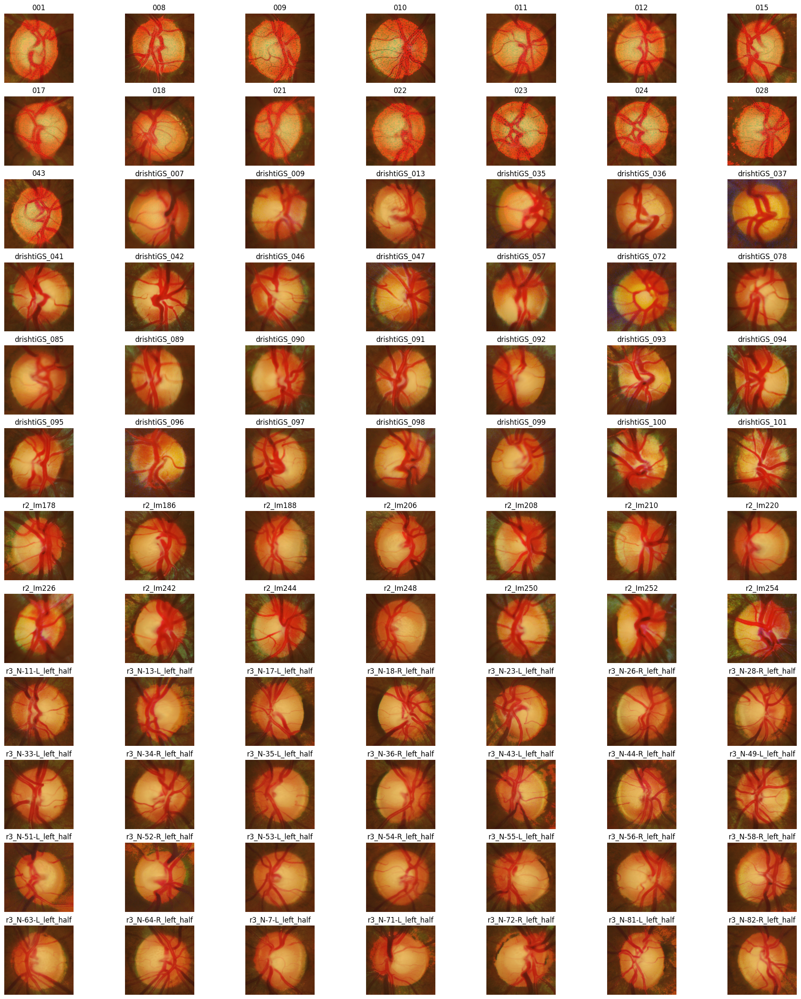

In [137]:
display_all(pos_matched,(12,7), (25,30))

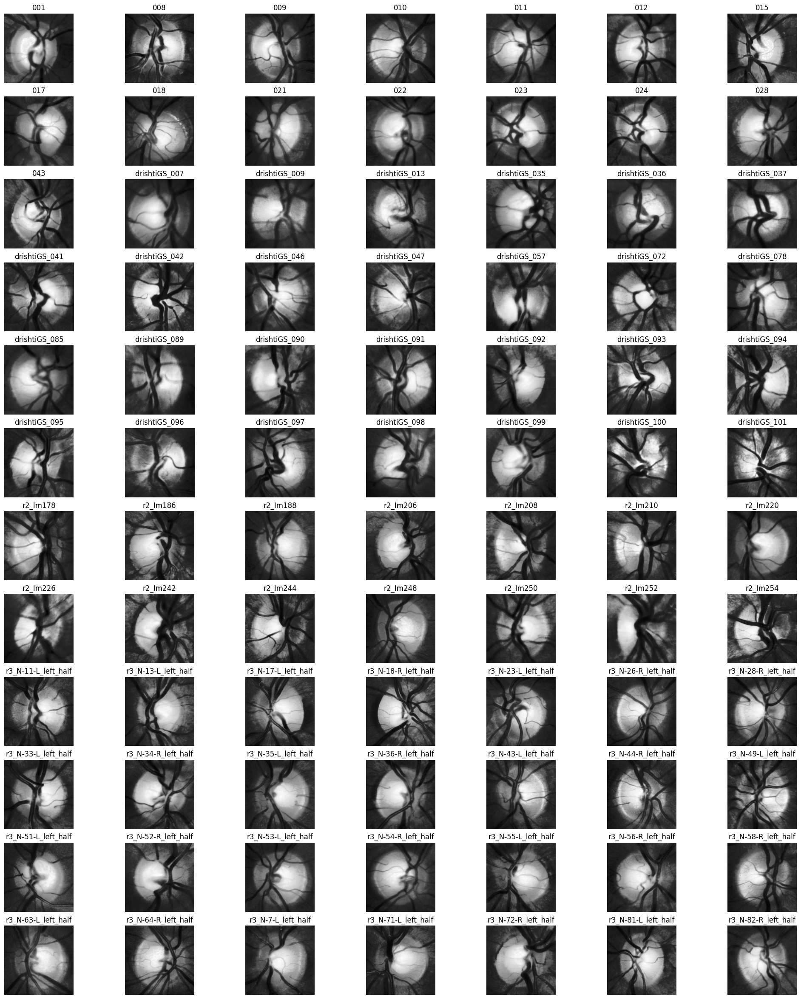

In [186]:
display_all_with(pos_matched, 1, (12,7), (25,30))

In [206]:
blurred = {}
for img in pos_matched:
    blurred[img] = cv2.GaussianBlur(pos_matched[img][:,:,2], (75,75), 0)

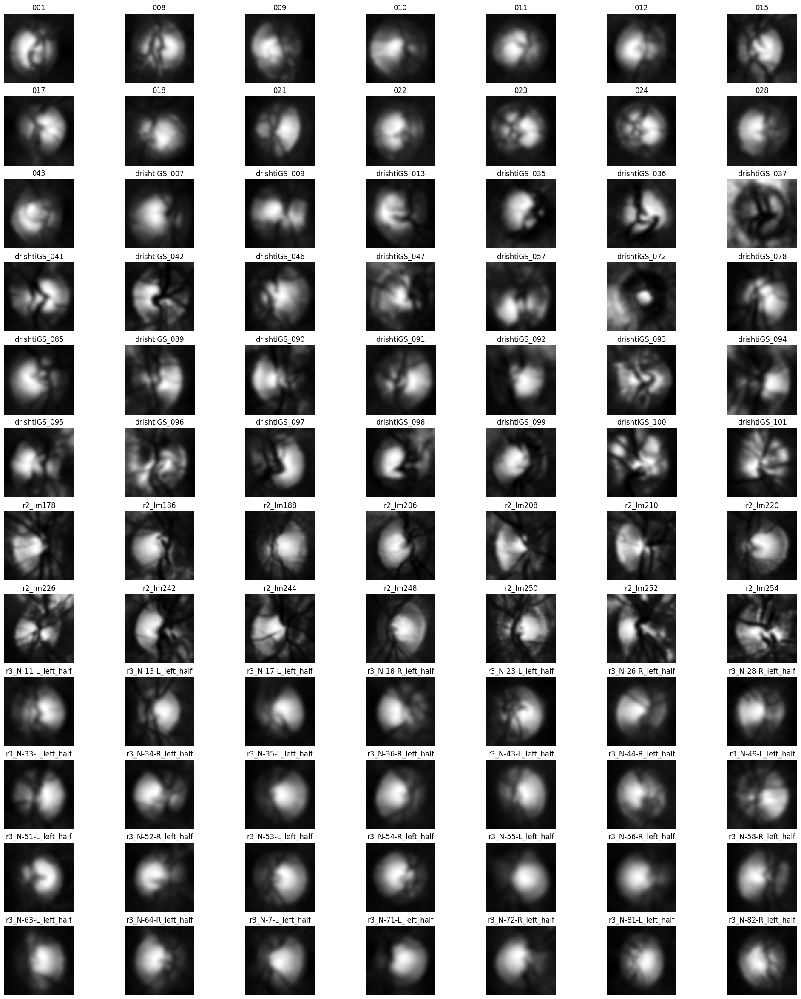

In [207]:
display_all(blurred, (12,7), (25,30), True)

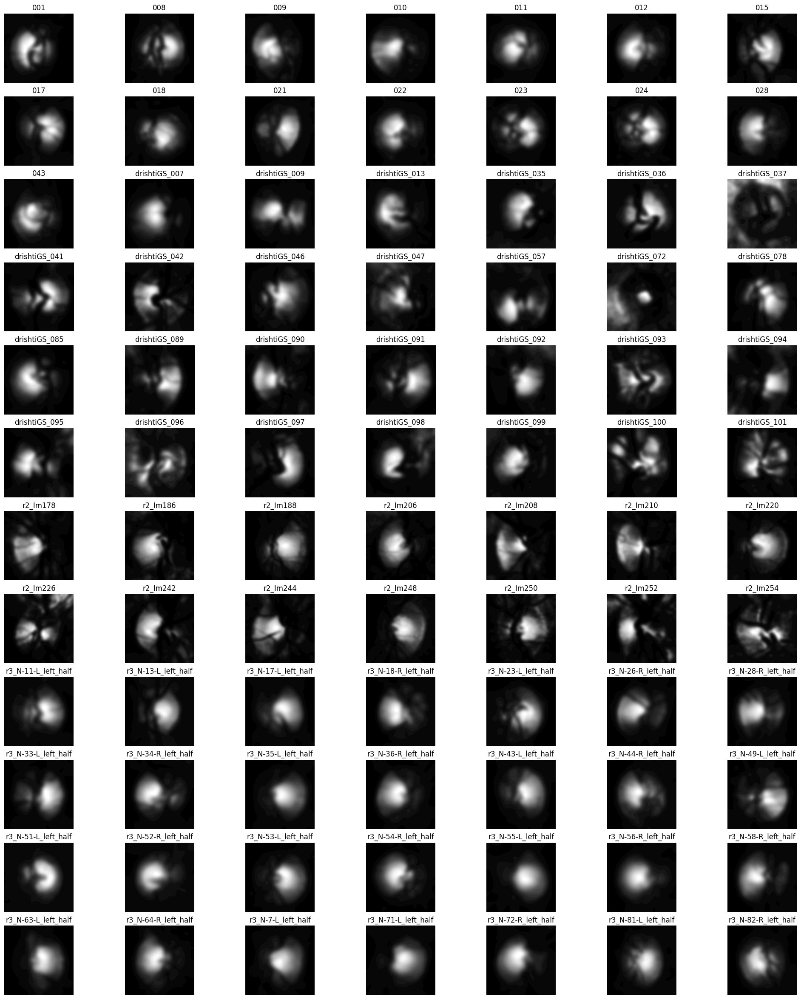

In [211]:
adjusted = {}
for bl in blurred:
    adjusted[bl] = adjust_gamma(blurred[bl], 2)
display_all(adjusted, (12,7), (25,30), True)

In [212]:
thd = {}
for img in adjusted:
    ret, thd[img] = cv2.threshold(adjusted[img], 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)

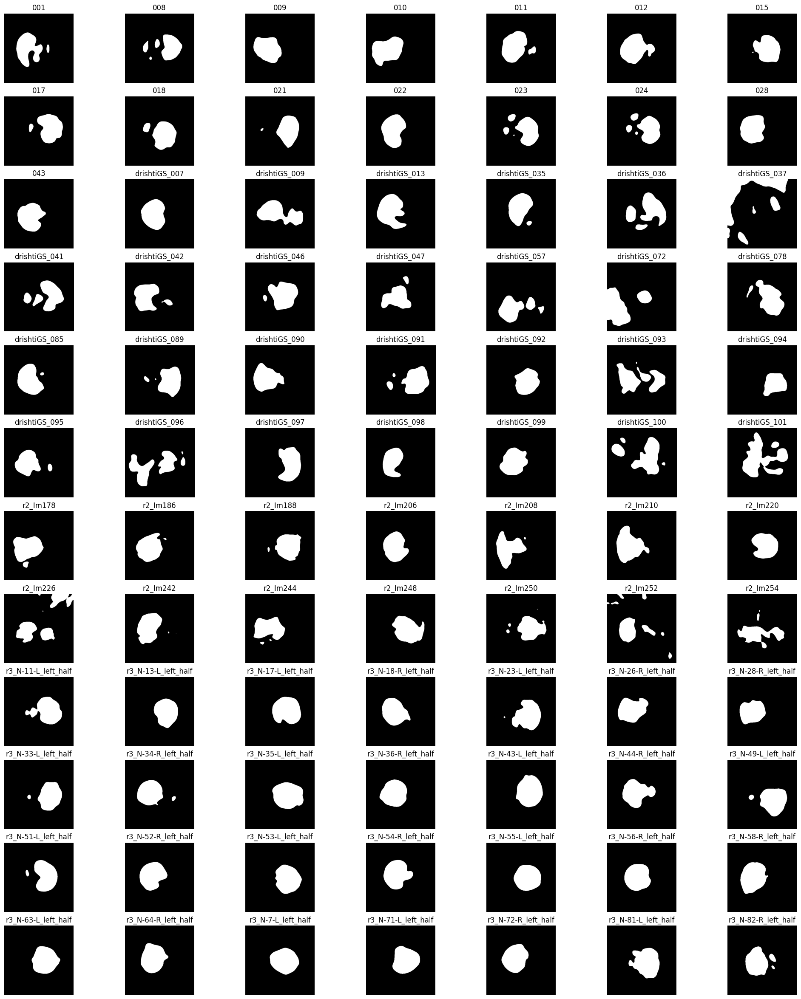

In [213]:
display_all(thd, (12,7), (25,30), True)

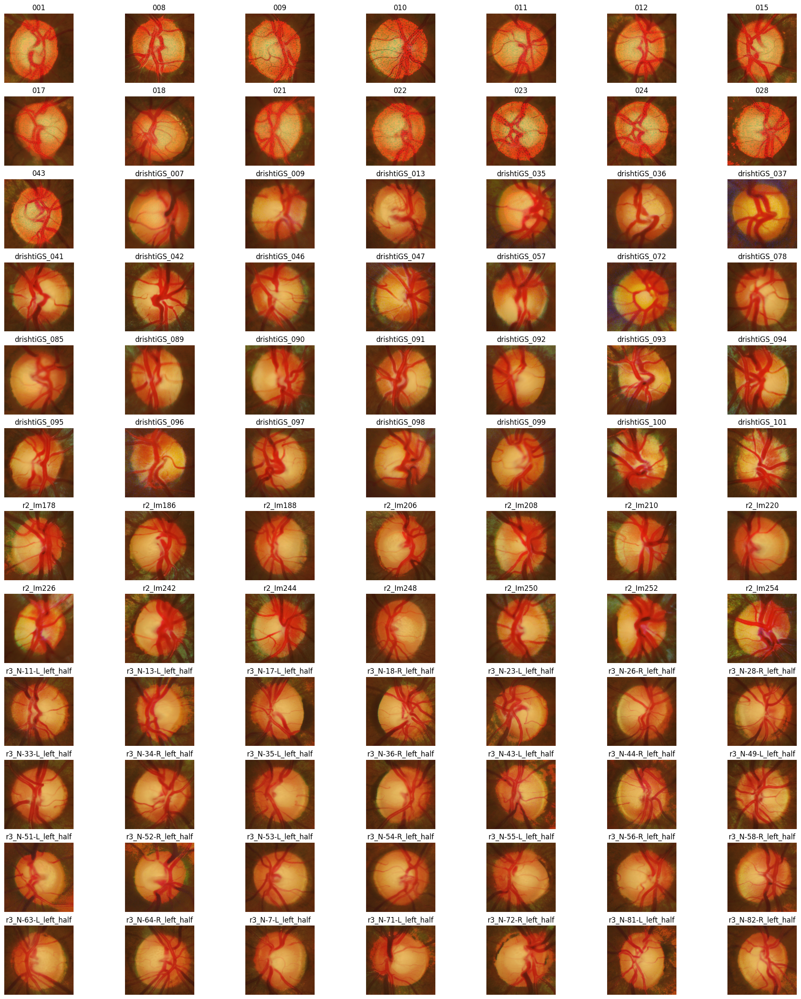

In [214]:
display_all(pos_matched, (12,7), (25,30), True)

In [237]:
morph = {}
for img in pos_matched:
    opened = cv2.morphologyEx(pos_matched[img], cv2.MORPH_OPEN, kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (30,30)))
    morph[img] = cv2.morphologyEx(opened, cv2.MORPH_CLOSE, kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5)))

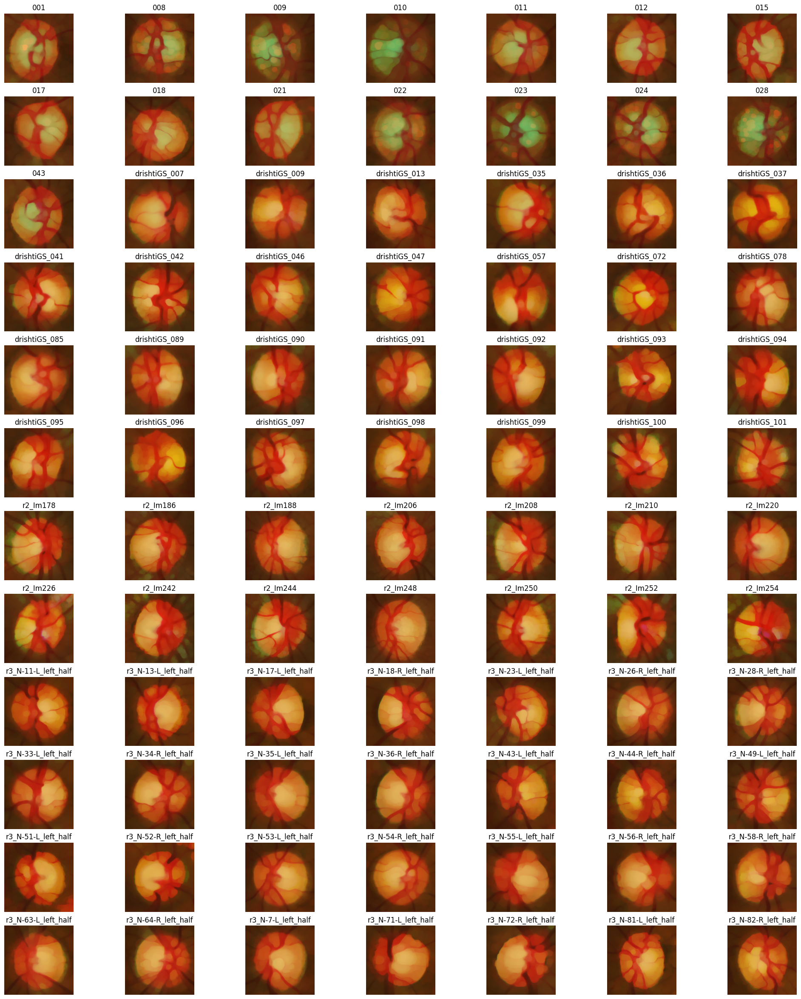

In [238]:
display_all(morph, (12,7), (25,30))

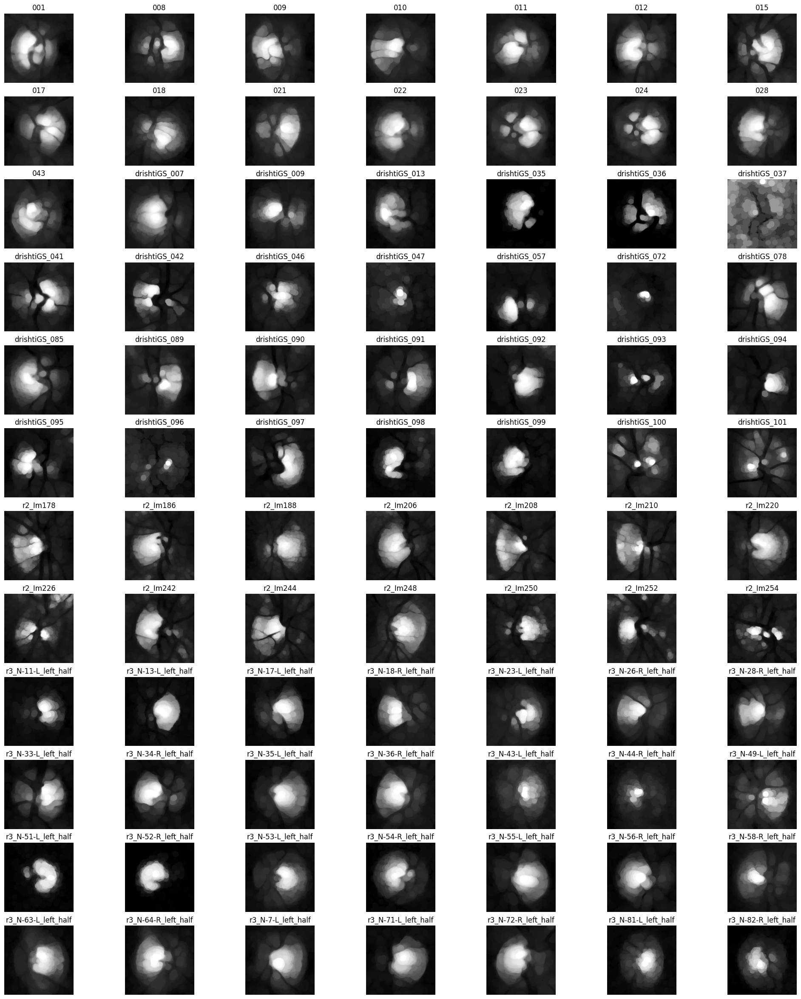

In [239]:
display_all_with(morph, 2, (12,7), (25,30), True)

In [241]:
thd = {}
for img in adjusted:
    ret, thd[img] = cv2.threshold(morph[img][:,:,2], 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)

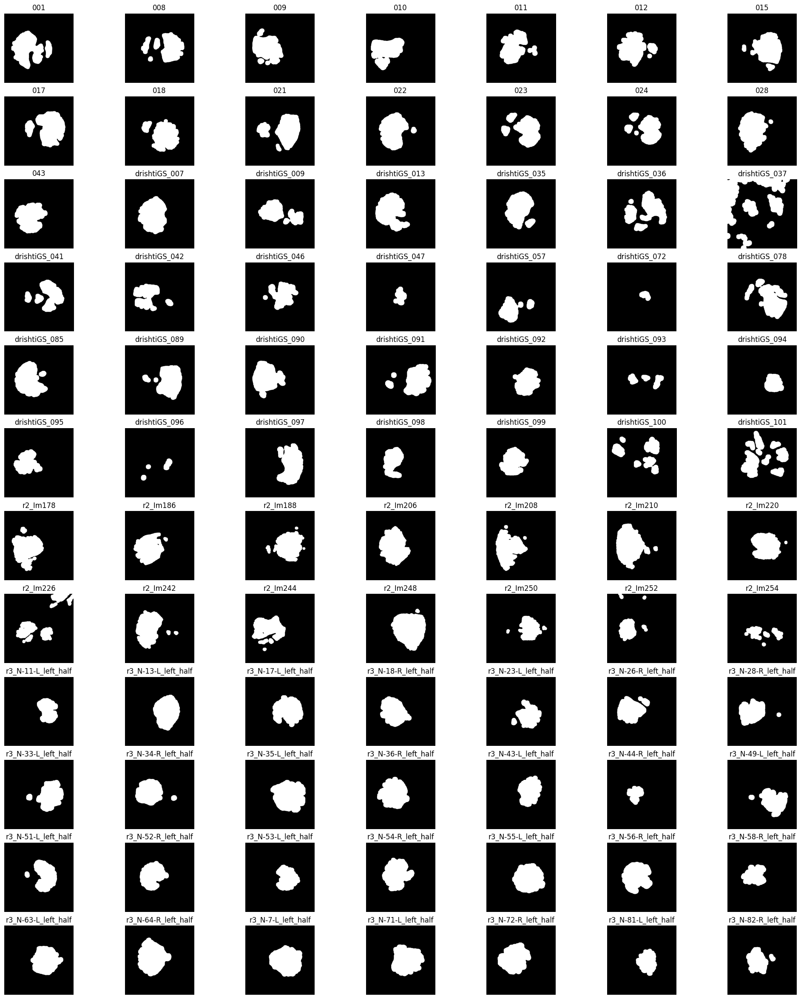

In [243]:
display_all(thd, (12,7), (25,30), True)

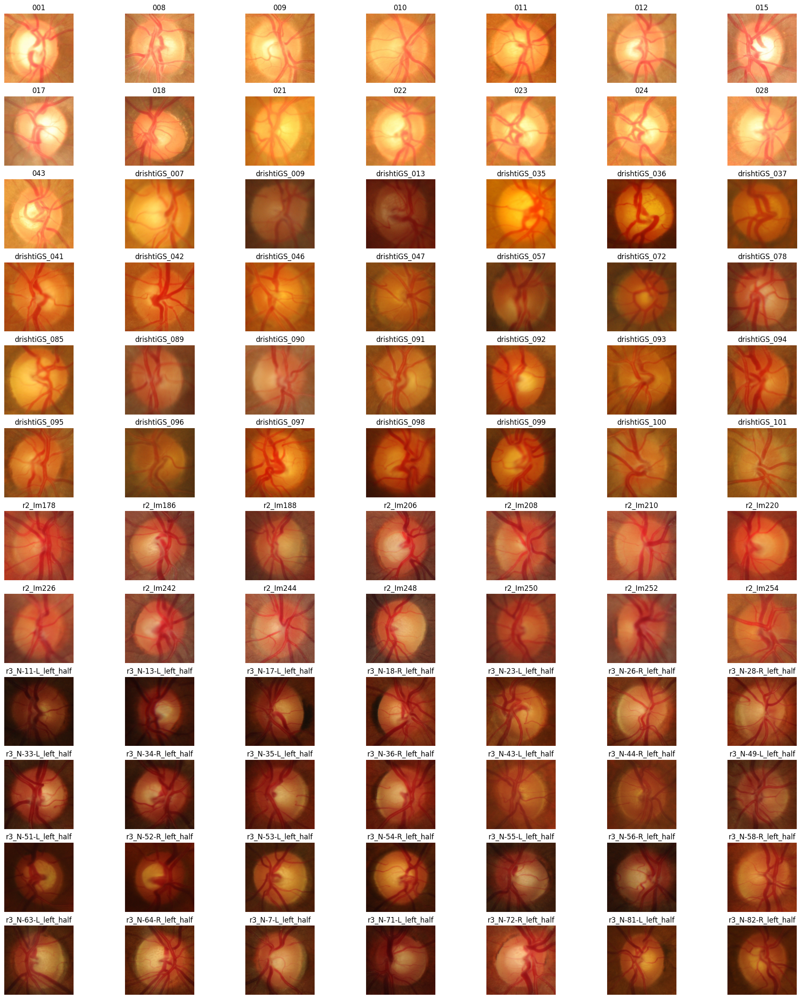

In [244]:
display_all(neg, (12,7), (25,30), True)

In [247]:
IDEAL_DIR = r'/home/tsdhrm/Pictures/thesis/dataset/100DataNew/negative/r3_N-13-L_left_half.png'
NEW_IDEAL = cv2.imread(IDEAL_DIR)
NEW_IDEAL = cv2.cvtColor(NEW_IDEAL, cv2.COLOR_BGR2RGB)

In [248]:
neg_match = {}
for p in neg:
    neg_match[p] = match_histograms(neg[p], NEW_IDEAL, multichannel=True)

/tmp/ipykernel_24985/1663529637.py:3: FutureWarning: `multichannel` is a deprecated argument name for `match_histograms`. It will be removed in version 1.0. Please use `channel_axis` instead.
  neg_match[p] = match_histograms(neg[p], NEW_IDEAL, multichannel=True)


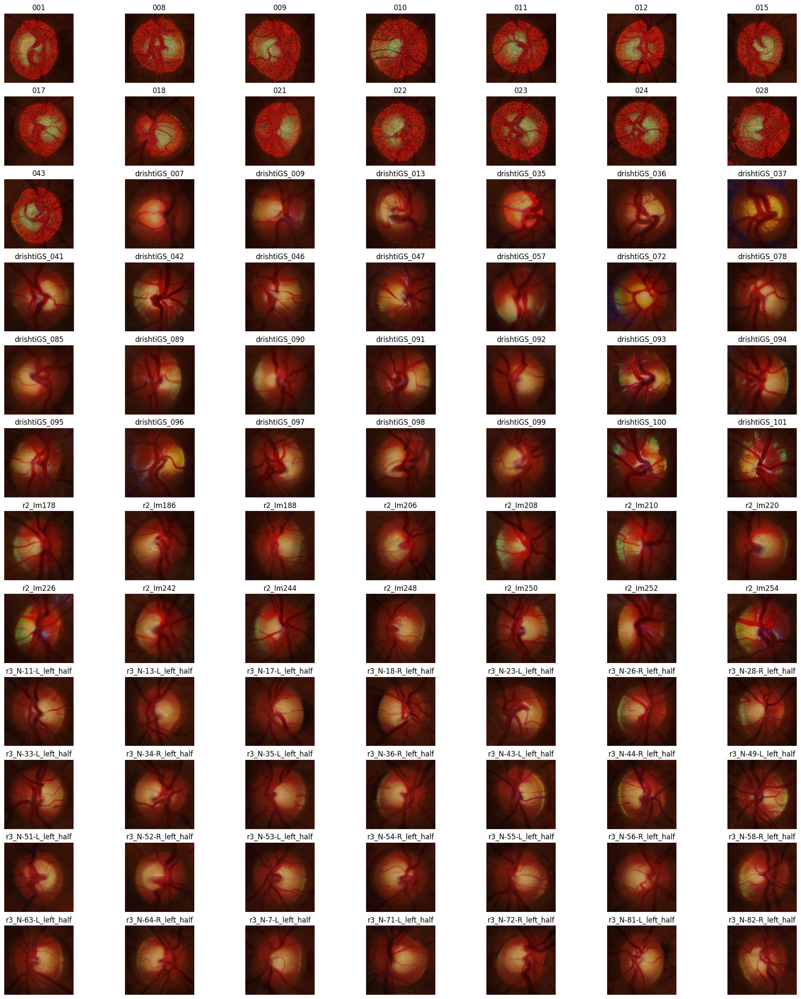

In [249]:
display_all(neg_match, (12,7), (25,30))

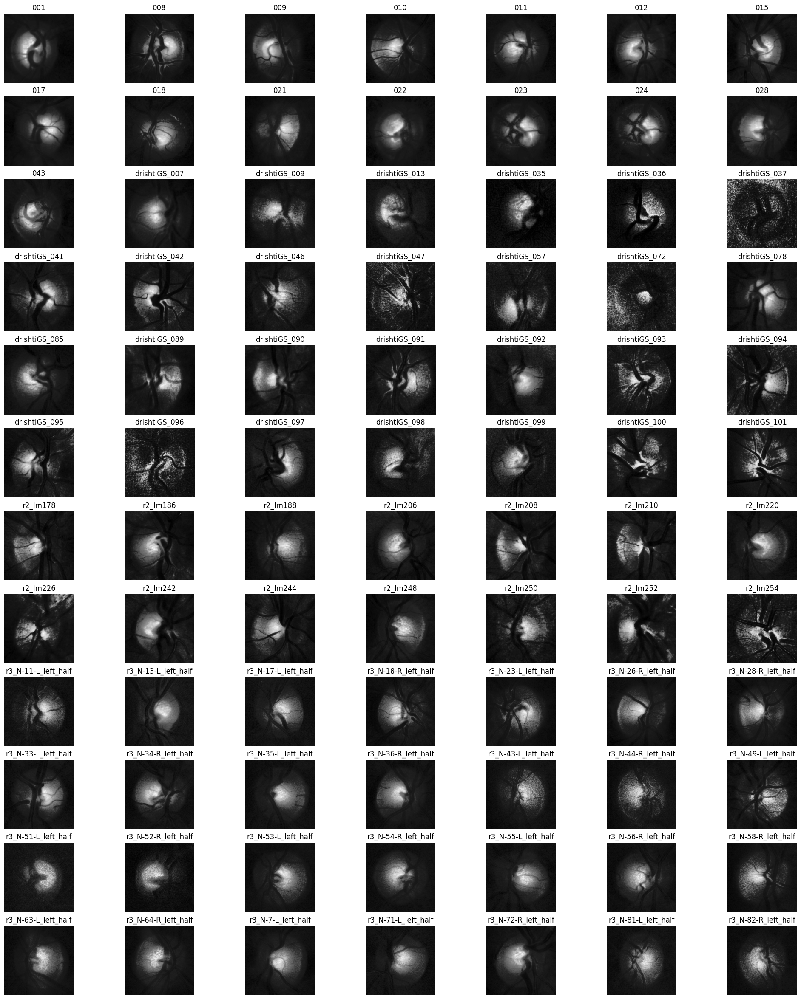

In [251]:
display_all_with(neg_match, 2, (12,7), (25,30), True)